### Importación de datos



In [41]:
import pandas as pd
import matplotlib.pyplot as plt


url = "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science-latam/refs/heads/main/base-de-datos-challenge1-latam/tienda_1%20.csv"
url2 = "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science-latam/refs/heads/main/base-de-datos-challenge1-latam/tienda_2.csv"
url3 = "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science-latam/refs/heads/main/base-de-datos-challenge1-latam/tienda_3.csv"
url4 = "https://raw.githubusercontent.com/alura-es-cursos/challenge1-data-science-latam/refs/heads/main/base-de-datos-challenge1-latam/tienda_4.csv"

tienda = pd.read_csv(url)
tienda2 = pd.read_csv(url2)
tienda3 = pd.read_csv(url3)
tienda4 = pd.read_csv(url4)

tienda

,Producto,Categoría del Producto,Precio,Costo de envío,Fecha de Compra,Vendedor,Lugar de Compra,Calificación,Método de pago,Cantidad de cuotas,lat,lon
0,Asistente virtual,Electrónicos,164300.0,6900.0,16/01/2021,Pedro Gomez,Bogotá,4,Tarjeta de crédito,8,4.60971,-74.08175
1,Mesa de comedor,Muebles,192300.0,8400.0,18/05/2022,Beatriz Morales,Medellín,1,Tarjeta de crédito,4,6.25184,-75.56359
2,Juego de mesa,Juguetes,209600.0,15900.0,15/03/2021,Juan Fernandez,Cartagena,1,Tarjeta de crédito,1,10.39972,-75.51444
3,Microondas,Electrodomésticos,757500.0,41000.0,03/05/2022,Juan Fernandez,Cali,4,Nequi,1,3.43722,-76.52250
4,Silla de oficina,Muebles,335200.0,20200.0,07/11/2020,Maria Alfonso,Medellín,5,Nequi,1,6.25184,-75.56359
...,...,...,...,...,...,...,...,...,...,...,...,...
2354,Iphone 15,Electrónicos,1284400.0,66600.0,15/11/2021,Izabela de León,Medellín,1,Nequi,1,6.25184,-75.56359
2355,Impresora,Electrónicos,282800.0,15300.0,18/03/2023,Lucas Olivera,Bogotá,5,Nequi,1,4.60971,-74.08175
2356,Juego de mesa,Juguetes,122900.0,7200.0,06/07/2021,Lucas Olivera,Cali,5,Tarjeta de crédito,4,3.43722,-76.52250
2357,Cama box,Muebles,691300.0,35000.0,02/05/2022,Pedro Gomez,Pasto,1,Tarjeta de crédito,2,1.21361,-77.28111


In [22]:
tienda['Num tienda'] = 1
tienda2['Num tienda'] = 2
tienda3['Num tienda'] = 3
tienda4['Num tienda'] = 4
tienda_completa = pd.concat([ tienda, tienda2, tienda3, tienda4], ignore_index=True)

#1. Análisis de facturación



In [13]:
ingreso_por_tienda = tienda_completa.groupby('Num tienda')['Precio'].sum()

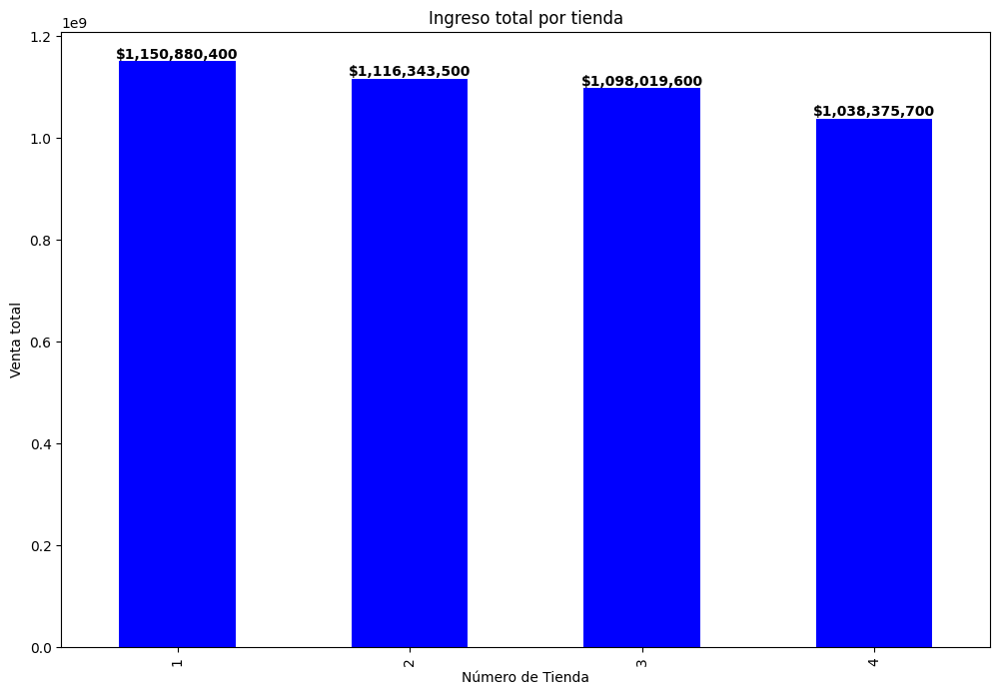

In [14]:
ax = ingreso_por_tienda.plot(kind='bar', figsize=(12,8), color="blue",
                             xlabel="Número de Tienda", ylabel="Venta total")
for i, v in enumerate(ingreso_por_tienda):
    ax.text(i, v, f'${v:,.0f}',
            ha='center', va='bottom', fontweight='bold')
plt.title('Ingreso total por tienda')
plt.show()

# 2. Ventas por categoría

In [15]:
articulos_populares_tienda1 = (tienda.groupby('Categoría del Producto')['Producto'].count().sort_values(ascending=False).reset_index())
articulos_populares_tienda1['Porcentaje'] = articulos_populares_tienda1['Producto'] / articulos_populares_tienda1.Producto.sum()
articulos_populares_tienda1_top = articulos_populares_tienda1.head(5)
articulos_populares_tienda1_top['Tienda'] = 1
## dan el 85%

articulos_populares_tienda2 = (tienda2.groupby('Categoría del Producto')['Producto'].count().sort_values(ascending=False).reset_index())
articulos_populares_tienda2['Porcentaje'] = articulos_populares_tienda2['Producto'] / articulos_populares_tienda2.Producto.sum()
articulos_populares_tienda2_top = articulos_populares_tienda2.head(5)
articulos_populares_tienda2_top['Tienda'] = 2
## dan el 83%

articulos_populares_tienda3 = (tienda3.groupby('Categoría del Producto')['Producto'].count().sort_values(ascending=False).reset_index())
articulos_populares_tienda3['Porcentaje'] = articulos_populares_tienda3['Producto'] / articulos_populares_tienda3.Producto.sum()
articulos_populares_tienda3_top = articulos_populares_tienda3.head(5)
articulos_populares_tienda3_top['Tienda'] = 3
## dan el 85%

articulos_populares_tienda4 = (tienda4.groupby('Categoría del Producto')['Producto'].count().sort_values(ascending=False).reset_index())
articulos_populares_tienda4['Porcentaje'] = articulos_populares_tienda4['Producto'] / articulos_populares_tienda4.Producto.sum()
articulos_populares_tienda4_top = articulos_populares_tienda4.head(5)
articulos_populares_tienda4_top['Tienda'] = 4
## dan el 84%

articulos_populares_tienda_total = pd.concat([ articulos_populares_tienda1_top, articulos_populares_tienda2_top, articulos_populares_tienda3_top, articulos_populares_tienda4_top], ignore_index=True)

/tmp/ipython-input-464442090.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  articulos_populares_tienda1_top['Tienda'] = 1
/tmp/ipython-input-464442090.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  articulos_populares_tienda2_top['Tienda'] = 2
/tmp/ipython-input-464442090.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

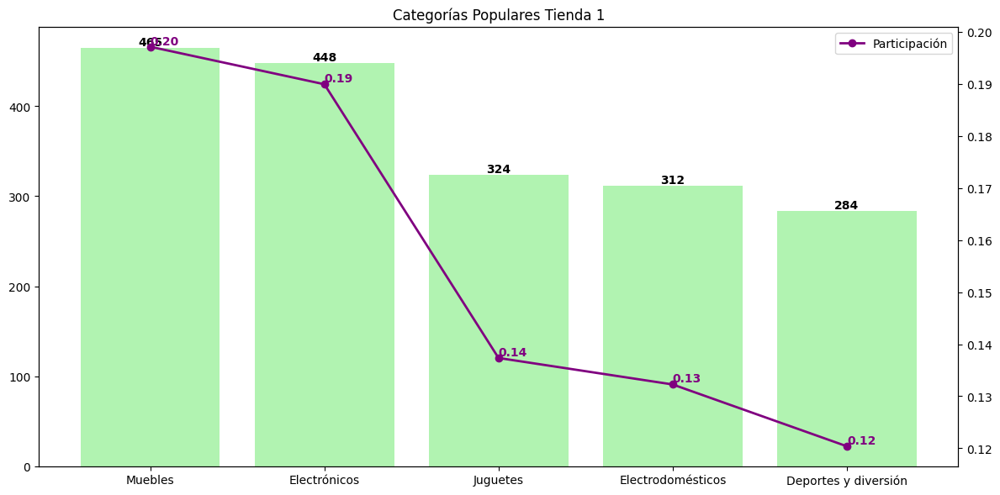

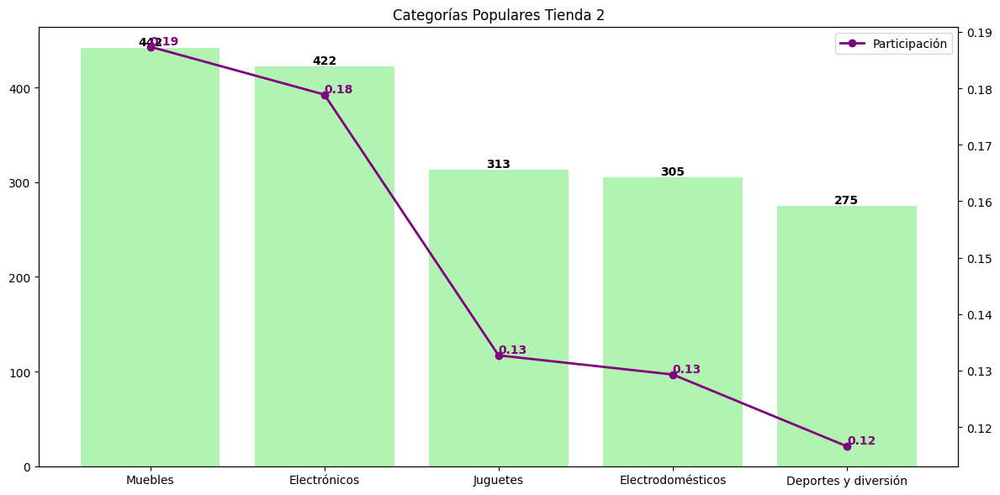

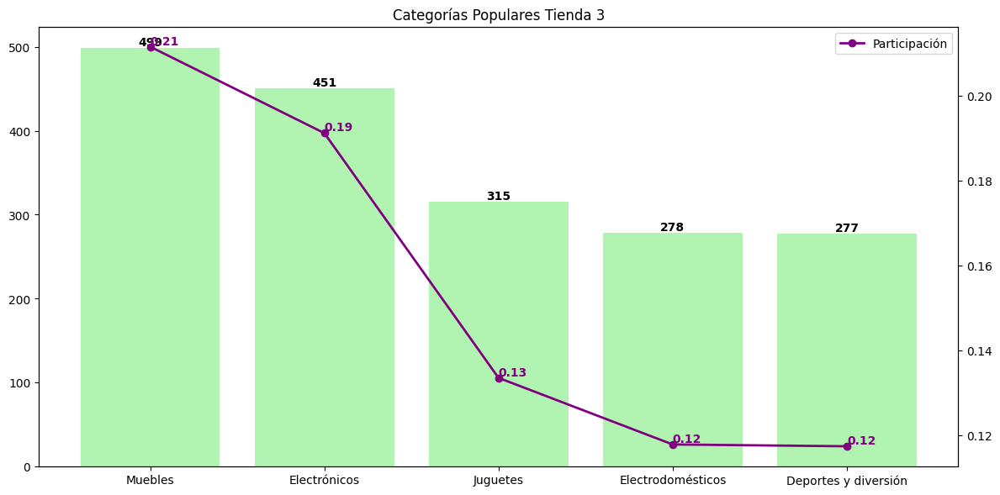

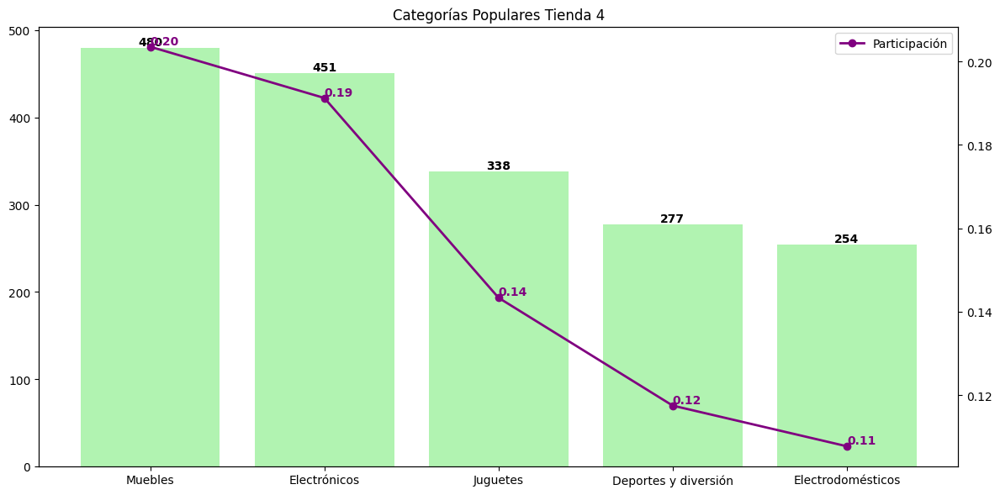

In [16]:
# Gráfica de la tienda 1
plt.figure(figsize=(12, 6))
bars = plt.bar(articulos_populares_tienda1_top['Categoría del Producto'], articulos_populares_tienda1_top['Producto'], color='lightgreen', alpha=0.7, label='Cantidad')
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height, f'{height:.0f}', ha='center', va='bottom', fontweight='bold')
ax2 = plt.gca().twinx()
line = ax2.plot(articulos_populares_tienda1_top['Categoría del Producto'], articulos_populares_tienda1_top['Porcentaje'], color='purple', marker='o', linewidth=2, label='Participación')
for i, (categoria, porcentaje) in enumerate(zip(articulos_populares_tienda1_top['Categoría del Producto'], articulos_populares_tienda1_top['Porcentaje'])):
    ax2.text(i, porcentaje, f'{porcentaje:.2f}', ha='left', va='bottom', fontweight='bold', color='purple')
plt.title('Categorías Populares Tienda 1')
plt.legend(loc='upper left')
ax2.legend(loc='upper right')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Gráfica de la tienda 2
plt.figure(figsize=(12, 6))
bars = plt.bar(articulos_populares_tienda2_top['Categoría del Producto'], articulos_populares_tienda2_top['Producto'], color='lightgreen', alpha=0.7, label='Cantidad')
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height, f'{height:.0f}', ha='center', va='bottom', fontweight='bold')
ax2 = plt.gca().twinx()
line = ax2.plot(articulos_populares_tienda2_top['Categoría del Producto'], articulos_populares_tienda2_top['Porcentaje'], color='purple', marker='o', linewidth=2, label='Participación')
for i, (categoria, porcentaje) in enumerate(zip(articulos_populares_tienda2_top['Categoría del Producto'], articulos_populares_tienda2_top['Porcentaje'])):
    ax2.text(i, porcentaje, f'{porcentaje:.2f}', ha='left', va='bottom', fontweight='bold', color='purple')
plt.title('Categorías Populares Tienda 2')
plt.legend(loc='upper left')
ax2.legend(loc='upper right')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Gráfica de la tienda 3
plt.figure(figsize=(12, 6))
bars = plt.bar(articulos_populares_tienda3_top['Categoría del Producto'], articulos_populares_tienda3_top['Producto'], color='lightgreen', alpha=0.7, label='Cantidad')
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height, f'{height:.0f}', ha='center', va='bottom', fontweight='bold')
ax2 = plt.gca().twinx()
line = ax2.plot(articulos_populares_tienda3_top['Categoría del Producto'], articulos_populares_tienda3_top['Porcentaje'], color='purple', marker='o', linewidth=2, label='Participación')
for i, (categoria, porcentaje) in enumerate(zip(articulos_populares_tienda3_top['Categoría del Producto'], articulos_populares_tienda3_top['Porcentaje'])):
    ax2.text(i, porcentaje, f'{porcentaje:.2f}', ha='left', va='bottom', fontweight='bold', color='purple')
plt.title('Categorías Populares Tienda 3')
plt.legend(loc='upper left')
ax2.legend(loc='upper right')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Gráfica de la tienda 4
plt.figure(figsize=(12, 6))
bars = plt.bar(articulos_populares_tienda4_top['Categoría del Producto'], articulos_populares_tienda4_top['Producto'], color='lightgreen', alpha=0.7, label='Cantidad')
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height, f'{height:.0f}', ha='center', va='bottom', fontweight='bold')
ax2 = plt.gca().twinx()
line = ax2.plot(articulos_populares_tienda4_top['Categoría del Producto'], articulos_populares_tienda4_top['Porcentaje'], color='purple', marker='o', linewidth=2, label='Participación')
for i, (categoria, porcentaje) in enumerate(zip(articulos_populares_tienda4_top['Categoría del Producto'], articulos_populares_tienda4_top['Porcentaje'])):
    ax2.text(i, porcentaje, f'{porcentaje:.2f}', ha='left', va='bottom', fontweight='bold', color='purple')
plt.title('Categorías Populares Tienda 4')
plt.legend(loc='upper left')
ax2.legend(loc='upper right')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# 3. Calificación promedio de la tienda


In [17]:
calificación_por_tienda = (tienda_completa.groupby('Num tienda')['Calificación'].mean())
calificación_por_tienda = calificación_por_tienda.to_frame().reset_index()

/tmp/ipython-input-2692819963.py:15: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


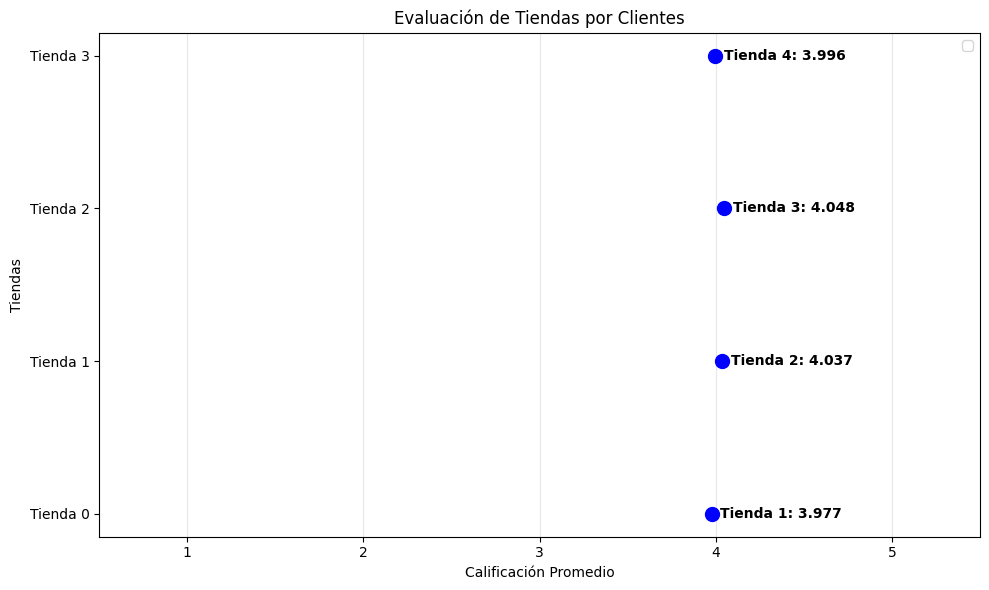

In [18]:
plt.figure(figsize=(10, 6))
tiendas = calificación_por_tienda.index.tolist()  # [1, 2, 3, 4]
calificaciones = calificación_por_tienda['Calificación'].values
plt.scatter(calificaciones, tiendas, color='blue', s=100, zorder=3)
for i, (tienda, calif) in enumerate(zip(tiendas, calificaciones)):
    plt.text(calif + 0.05, tienda,
             f'Tienda {tienda+1}: {calif:.3f}',
             va='center', fontsize=10, fontweight='bold')
plt.yticks(tiendas, [f'Tienda {t}' for t in tiendas])
plt.xlabel('Calificación Promedio')
plt.ylabel('Tiendas')
plt.title('Evaluación de Tiendas por Clientes')
plt.xlim(0.5, 5.5)
plt.grid(True, axis='x', alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()

# 4. Productos más y menos vendidos

In [29]:
productos_mas_vendidos_tienda1 = (tienda_completa[tienda_completa['Num tienda'] == 1].groupby(['Num tienda','Producto'])['Producto'].count().sort_values(ascending=False).head(3).reset_index(name='Cantidad'))
productos_menos_vendidos_tienda1 = (tienda_completa[tienda_completa['Num tienda'] == 1].groupby(['Num tienda','Producto'])['Producto'].count().sort_values(ascending=False).tail(3).reset_index(name='Cantidad'))
productos_mas_vendidos_tienda2 = (tienda_completa[tienda_completa['Num tienda'] == 2].groupby(['Num tienda','Producto'])['Producto'].count().sort_values(ascending=False).head(3).reset_index(name='Cantidad'))
productos_menos_vendidos_tienda2 = (tienda_completa[tienda_completa['Num tienda'] == 2].groupby(['Num tienda','Producto'])['Producto'].count().sort_values(ascending=False).tail(3).reset_index(name='Cantidad'))
productos_mas_vendidos_tienda3 = (tienda_completa[tienda_completa['Num tienda'] == 3].groupby(['Num tienda','Producto'])['Producto'].count().sort_values(ascending=False).head(3).reset_index(name='Cantidad'))
productos_menos_vendidos_tienda3 = (tienda_completa[tienda_completa['Num tienda'] == 3].groupby(['Num tienda','Producto'])['Producto'].count().sort_values(ascending=False).tail(3).reset_index(name='Cantidad'))
productos_mas_vendidos_tienda4 = (tienda_completa[tienda_completa['Num tienda'] == 4].groupby(['Num tienda','Producto'])['Producto'].count().sort_values(ascending=False).head(3).reset_index(name='Cantidad'))
productos_menos_vendidos_tienda4 = (tienda_completa[tienda_completa['Num tienda'] == 4].groupby(['Num tienda','Producto'])['Producto'].count().sort_values(ascending=False).tail(3).reset_index(name='Cantidad'))
productos_mas_vendidos = pd.concat([productos_mas_vendidos_tienda1, productos_mas_vendidos_tienda2, productos_mas_vendidos_tienda3, productos_mas_vendidos_tienda4], ignore_index=True)
productos_menos_vendidos = pd.concat([productos_menos_vendidos_tienda1, productos_menos_vendidos_tienda2, productos_menos_vendidos_tienda3, productos_menos_vendidos_tienda4], ignore_index=True)

In [24]:
import plotly.graph_objects as go
data = {
    'Num tienda': productos_mas_vendidos['Num tienda'],
    'Producto': productos_mas_vendidos['Producto'],
    'Cantidad': productos_mas_vendidos['Cantidad']
}
df = pd.DataFrame(data)
tiendas = [f"Tienda {i}" for i in sorted(df['Num tienda'].unique())]
productos = sorted(df['Producto'].unique())
nodes = tiendas + productos
node_indices = {node: i for i, node in enumerate(nodes)}
sources = []
targets = []
values = []

for _, row in df.iterrows():
    source_idx = node_indices[f"Tienda {row['Num tienda']}"]
    target_idx = node_indices[row['Producto']]
    sources.append(source_idx)
    targets.append(target_idx)
    values.append(row['Cantidad'])
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=nodes,
        color=["lightblue"] * len(tiendas) + ["lightgreen"] * len(productos)
    ),
    link=dict(
        source=sources,    # Índices de origen (tiendas)
        target=targets,    # Índices de destino (productos)
        value=values,      # Cantidades
        color="rgba(144,238,144,0.4)"  # Color de los flujos
    )
)])

fig.update_layout(
    title_text="Top 3 de productos más vendidos por tienda",
    font_size=12,
    height=600
)

fig.show()

data = {
    'Num tienda': productos_menos_vendidos['Num tienda'],
    'Producto': productos_menos_vendidos['Producto'],
    'Cantidad': productos_menos_vendidos['Cantidad']
}
df = pd.DataFrame(data)
tiendas = [f"Tienda {i}" for i in sorted(df['Num tienda'].unique())]
productos = sorted(df['Producto'].unique())
nodes = tiendas + productos
node_indices = {node: i for i, node in enumerate(nodes)}
sources = []
targets = []
values = []

for _, row in df.iterrows():
    source_idx = node_indices[f"Tienda {row['Num tienda']}"]
    target_idx = node_indices[row['Producto']]
    sources.append(source_idx)
    targets.append(target_idx)
    values.append(row['Cantidad'])
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=nodes,
        color=["lightblue"] * len(tiendas) + ["lightgreen"] * len(productos)
    ),
    link=dict(
        source=sources,    # Índices de origen (tiendas)
        target=targets,    # Índices de destino (productos)
        value=values,      # Cantidades
        color="rgba(255,0,0,0.4)"  # Color de los flujos
    )
)])

fig.update_layout(
    title_text="Top 3 de productos menos vendidos por tienda",
    font_size=12,
    height=600
)

fig.show()

# 5. Envío promedio por tienda

In [25]:
costo_envio_por_tienda = tienda_completa.groupby('Num tienda')['Costo de envío'].mean()
costo_envio_por_tienda

,Costo de envío
Num tienda,
1,26018.609580
2,25216.235693
3,24805.680373
4,23459.457167


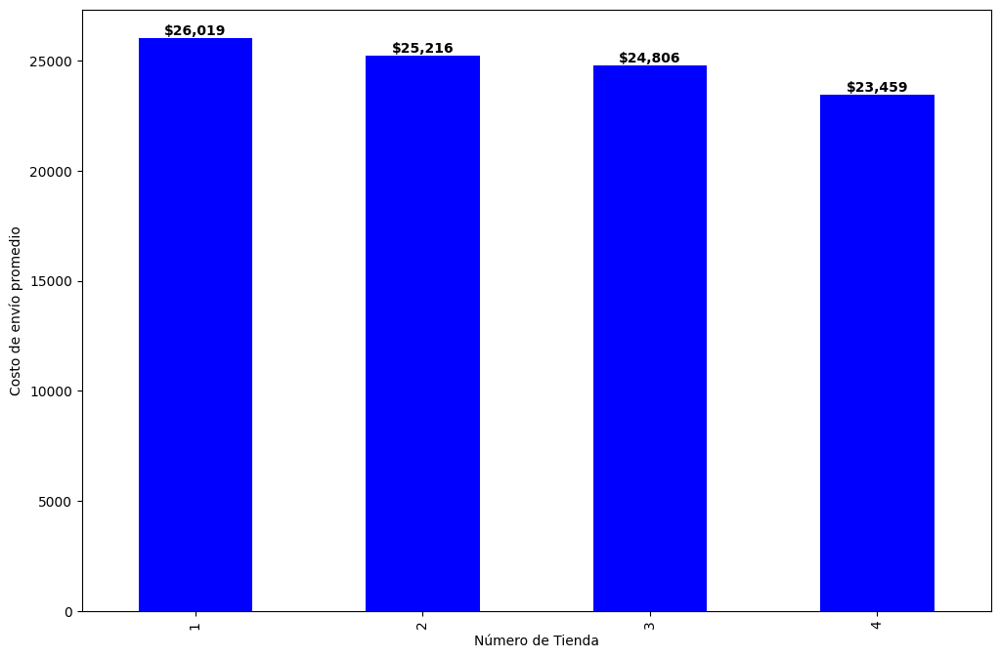

In [26]:
ax = costo_envio_por_tienda.plot(kind='bar', figsize=(12,8), color="blue",
                             xlabel="Número de Tienda", ylabel="Costo de envío promedio")
for i, v in enumerate(costo_envio_por_tienda):
    ax.text(i, v, f'${v:,.0f}',
            ha='center', va='bottom', fontweight='bold')

plt.show()

In [27]:
tienda_completa_rentabilidad = tienda_completa.groupby(['Num tienda']).agg({
    'Vendedor': 'count',
    'Precio': 'sum',
    'Costo de envío': 'sum',
})
tienda_completa_rentabilidad['Rentabilidad'] = tienda_completa_rentabilidad['Precio'] - tienda_completa_rentabilidad['Costo de envío']
tienda_completa_rentabilidad['Precio'] = tienda_completa_rentabilidad['Precio'].map(lambda x: f"${x:,.2f}")
tienda_completa_rentabilidad['Costo de envío'] = tienda_completa_rentabilidad['Costo de envío'].map(lambda x: f"${x:,.2f}")
tienda_completa_rentabilidad['Rentabilidad'] = tienda_completa_rentabilidad['Rentabilidad'].map(lambda x: f"${x:,.2f}")
tienda_completa_rentabilidad

,Vendedor,Precio,Costo de envío,Rentabilidad
Num tienda,,,,
1,2359,"$1,150,880,400.00","$61,377,900.00","$1,089,502,500.00"
2,2359,"$1,116,343,500.00","$59,485,100.00","$1,056,858,400.00"
3,2359,"$1,098,019,600.00","$58,516,600.00","$1,039,503,000.00"
4,2358,"$1,038,375,700.00","$55,317,400.00","$983,058,300.00"


# 6. Conlusión

Estimado Sr. Juan, con base al análisis generado con la información de facturación de sus tiendas, le recomiendo cerrar la tienda #4, a continuación le describo el porqué de la decisión.

Para dicho análisis se utilizó la información histórica de facturación de cada una de las tiendas, tomando en cuenta los siguientes aspectos:

- **Facturación Total de cada tienda**

  Desde aquí se observa que la tienda #4 es la que menor facturación presenta, aunque hasta este punto no hay evidencia suficiente para decantarnos por esta opción.

- **Categorías más populares**

  Utilizando el principio de pareto, nos enfocamos en aquellas categorías que representaran al menos el 80% de las ventas total de cada tienda. En este punto no encontramos información suficiente de descarte ya que se repetían las mismas categorías en las 4 tiendas.

  Nota: esta información podría servir para realizar una estrategia de pricing a la alza sobre aquellas categorías/productos con más venta.

- **Promedio de calificación de los clientes**

  En este punto, se observa que las 4 tiendas muestran una calificación similar, sin evidencia clara de descartar alguna de las cuatro tiendas.

- **Productos más y menos vendidos**

  Enfocándonos en la tienda que sugiero como descarte (tienda #4), encontré que las guitarras tanto eléctrica como acústica son 2 de los 3 productos menos vendidos en esta tienda, incentivar la venta de estos productos podría beneficiar al desempeño de la tienda.

- **Costo promedio del envío**

  Este último punto nos contradice un poco la decisión final, ya que la tienda #4 es la que presenta el menor costo promedio de envío, uno pensaría que aunque sea la tienda con menor venta, si el costo de envío es menor que el resto, la rentabilidad podría verse mejor a comparación del resto de las demás tiendas, sin embargo, para sustentar y complementar la decisión final, obtuve la rentabilidad por tienda y el resultado fue el siguiente:

  La tienda #4 es la que menor ingreso representa y que a pesar de tener el menor costo por envío, éste no es lo suficientemente bajo como para generar una rentabilidad por encima del resto de las tiendas, por lo que se sugiere que la tienda #4 es la que tendría que cerrar.



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# 7. Extra

In [40]:
import folium
from folium import plugins
import pandas as pd

data = {
    'Ciudad': tienda_completa['Lugar de Compra'],
    'Latitud': tienda_completa['lat'],
    'Longitud': tienda_completa['lon'],
    'Venta': tienda_completa['Precio'],
    'Calificación': tienda_completa['Calificación']
}

df = pd.DataFrame(data)
mapa = folium.Map(location=[4.60971,	-74.08175], zoom_start=6)
for idx, row in df.iterrows():
    folium.Marker(
        location=[row['Latitud'], row['Longitud']],
        popup=f"{row['Ciudad']} <br>Venta: ${row['Venta']:,.0f} <br>Calificación: {row['Calificación']:,.1f}  ",
        tooltip=row['Ciudad'],
        icon=folium.Icon(color='green' if row['Calificación'] > 3.5 else 'red')
    ).add_to(mapa)

mapa